# HHA550_Stroke Prediction Dataset

## Healtcare-dataset-Diabetes-Data

## PreReq
#import/install everything need

In [58]:
#Commands to install some of the libraries in-case if they are not installed
#Any other library that needs to be installed just use: !pip install <library name>
!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearn
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
!pip install -U scikit-learn
!pip install nbformat==4.2.0


^C


In [84]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction
from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching
import nbformat 
# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

## Only use when needed

In [89]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")
# problem with these imports
# from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score,\
#                             precision_score, recall_score, roc_auc_score,\
#                             plot_confusion_matrix, classification_report, plot_roc_curve, f1_score

In [115]:
#upload the csv and declare its name to = the csv
#for this course we will name the dataframe 'stroke', but you can change it to df or anything else you want.
#Find the file path to the .csv
#Then use code below to read .csv
diabetes = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandata.csv')

#### Looking at the data

In [ ]:
#make sure csv has been assigned to declared name and can be read
diabetes.head(10)
# this command will give you the first 5 lines of the csv (0,1,2,3,4)
# we are looking at the first 10

,Unnamed: 0,encounter_id,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,tolazamide,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,0,2278392,8222157,3,1,1,6,25,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,149190,55629189,3,1,2,1,1,7,3,...,0,3,0,0,0,0,0,1,1,1
2,2,64410,86047875,1,1,3,1,1,7,2,...,0,0,0,0,0,0,0,0,1,0
3,3,500364,82442376,3,2,4,1,1,7,2,...,0,3,0,0,0,0,0,1,1,0
4,4,16680,42519267,3,2,5,1,1,7,1,...,0,2,0,0,0,0,0,1,1,0
5,5,35754,82637451,3,2,6,2,1,2,3,...,0,2,0,0,0,0,0,0,1,1
6,6,55842,84259809,3,2,7,3,1,2,4,...,0,2,0,0,0,0,0,1,1,0
7,7,63768,114882984,3,2,8,1,1,7,5,...,0,0,0,0,0,0,0,0,1,1
8,8,12522,48330783,3,1,9,2,1,4,13,...,0,2,0,0,0,0,0,1,1,0
9,9,15738,63555939,3,1,10,3,3,4,12,...,0,2,0,0,0,0,0,1,1,0


In [ ]:
#Some more intial looks at the data to make sure proper cleanning has been done
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 47 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   Unnamed: 0                101766 non-null  int64 
 1   encounter_id              101766 non-null  int64 
 2   patient_nbr               101766 non-null  int64 
 3   race                      101766 non-null  int64 
 4   gender                    101766 non-null  int64 
 5   age                       101766 non-null  int64 
 6   admission_type_id         101766 non-null  int64 
 7   discharge_disposition_id  101766 non-null  int64 
 8   admission_source_id       101766 non-null  int64 
 9   time_in_hospital          101766 non-null  int64 
 10  medical_specialty         101766 non-null  int64 
 11  num_lab_procedures        101766 non-null  int64 
 12  num_procedures            101766 non-null  int64 
 13  num_medications           101766 non-null  int64 
 14  numb

# Exploring and Understanding the Data


### Initial Insights
* come back to finsh

# What are the current problems we have that need to be solved?
* come back to later 

## Insights into our target variable
* One of the first steps of exploratory data analysis should always be to look at what the values of y look like.

In [ ]:
y = diabetes['readmitted']
print(f'Percentage of patient that were not readmitted: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} patient)\nPercentage of patient that were readmitted after 30 days: % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patient)\nPercentage of patient that were readmitted before 30 days: % {round(y.value_counts(normalize=True)[2]*100,2)} --> ({y.value_counts()[2]} patient)')

Percentage of patient that were not readmitted: % 53.91 --> (54864 patient)
Percentage of patient that were readmitted after 30 days: % 34.93 --> (35545 patient)
Percentage of patient that were readmitted before 30 days: % 11.16 --> (11357 patient)


### So what does that all mean?
Our data looks consistent to analyze with all values being filled in each column

### Visualize Diabetes reamissions Rate

In [ ]:
fig = px.histogram(diabetes, x="readmitted", title='Readmitted', width=400, height=400)
fig.show()

## Decide on Metrics

* There is a skew towards the left

In [ ]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 47 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   Unnamed: 0                101766 non-null  int64 
 1   encounter_id              101766 non-null  int64 
 2   patient_nbr               101766 non-null  int64 
 3   race                      101766 non-null  int64 
 4   gender                    101766 non-null  int64 
 5   age                       101766 non-null  int64 
 6   admission_type_id         101766 non-null  int64 
 7   discharge_disposition_id  101766 non-null  int64 
 8   admission_source_id       101766 non-null  int64 
 9   time_in_hospital          101766 non-null  int64 
 10  medical_specialty         101766 non-null  int64 
 11  num_lab_procedures        101766 non-null  int64 
 12  num_procedures            101766 non-null  int64 
 13  num_medications           101766 non-null  int64 
 14  numb

In [ ]:
def missing (diabetes):
    missing_number = diabetes.isnull().sum().sort_values(ascending=False)
    missing_percent = (diabetes.isnull().sum()/diabetes.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(diabetes)

,Missing_Number,Missing_Percent
Unnamed: 0,0,0.0
miglitol,0,0.0
chlorpropamide,0,0.0
glimepiride,0,0.0
acetohexamide,0,0.0
glipizide,0,0.0
glyburide,0,0.0
tolbutamide,0,0.0
pioglitazone,0,0.0
rosiglitazone,0,0.0


# we can see that data has same count of values in each field with appropriate data types 
* check clean.py to see edits made or data dictonary to see further explanation

# Numerical Features
* Look at the data elements (columns) using `diabetes.head()`
* Look at the Dtype (data type) using `diabetes.info()`

In [ ]:
categorical = ['gender', 'race', 'admission_type_id', 'admission_source_id',
'medical_specialty', 'discharge_disposition_id', 'medical_specialty', 'diag_1', 'diag_2', 'diag_3',  ]

numerical = ['age','time_in_hospital', 'num_lab_procedures', 'num_procedures',
             'num_medications', 'number_outpatient', 'number_emergency', 'number_diagnoses', 'number_inpatient', ]

In [ ]:
diabetes[numerical].describe()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_diagnoses,number_inpatient
count,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000
mean,7.096702,4.395987,43.095641,1.339730,16.021844,0.369357,0.197836,7.422607,0.635566
std,1.594084,2.985108,19.674362,1.705807,8.127566,1.267265,0.930472,1.933600,1.262863
min,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,6.000000,2.000000,31.000000,0.000000,10.000000,0.000000,0.000000,6.000000,0.000000
50%,7.000000,4.000000,44.000000,1.000000,15.000000,0.000000,0.000000,8.000000,0.000000
75%,8.000000,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,9.000000,1.000000
max,10.000000,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,16.000000,21.000000


In [ ]:
diabetes[numerical].skew()

age                   -0.630539
time_in_hospital       1.133999
num_lab_procedures    -0.236544
num_procedures         1.316415
num_medications        1.326672
number_outpatient      8.832959
number_emergency      22.855582
number_diagnoses      -0.876746
number_inpatient       3.614139
dtype: float64

### We can see skewness in both left and right for numerical data, as seen above (16,17)
* Neagtive skew values mean skewness to the right 
* Postive skew values mean skewness to the left 

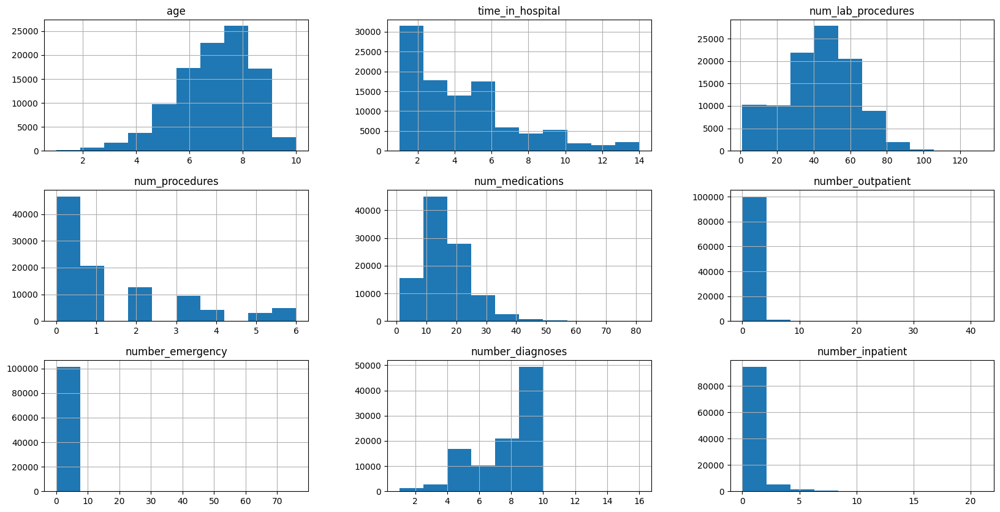

In [ ]:
diabetes[numerical].hist(figsize=(20,10));

# Categorical Feautres
* gender
* race
* admission_type_id
* admission_source_id
* medical_specialty
* discharge_disposition_id
* medical_specialty
* diag_1
* diag_2
* diag_3
 

### Gender

In [ ]:
print (f'{round(diabetes["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="gender", title='Gender', width=500, height=500)
fig.show()

1    53.76
2    46.24
0     0.00
Name: gender, dtype: float64


In [ ]:
print (f'{round(diabetes["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="race", title='Race', width=500, height=500)
fig.show()

3    74.78
1    18.88
0     2.23
4     2.00
5     1.48
2     0.63
Name: race, dtype: float64


In [ ]:
print (f'{round(diabetes["admission_type_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="admission_type_id", title='Admission_type_id', width=500, height=500)
fig.show()

1    53.05
3    18.54
2    18.16
6     5.20
5     4.70
8     0.31
7     0.02
4     0.01
Name: admission_type_id, dtype: float64


In [ ]:
print (f'{round(diabetes["discharge_disposition_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="discharge_disposition_id", title='discharge_disposition_id', width=750, height=750)
fig.show()

1     59.19
3     13.71
6     12.68
18     3.63
2      2.09
22     1.96
11     1.61
5      1.16
25     0.97
4      0.80
7      0.61
23     0.40
13     0.39
14     0.37
28     0.14
8      0.11
15     0.06
24     0.05
9      0.02
17     0.01
16     0.01
19     0.01
10     0.01
27     0.00
12     0.00
20     0.00
Name: discharge_disposition_id, dtype: float64


In [ ]:
print (f'{round(diabetes["admission_source_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="admission_source_id", title='admission_source_id', width=750, height=750)
fig.show()

7     56.50
1     29.05
17     6.66
4      3.13
6      2.22
2      1.08
5      0.84
3      0.18
20     0.16
9      0.12
8      0.02
22     0.01
10     0.01
14     0.00
11     0.00
25     0.00
13     0.00
Name: admission_source_id, dtype: float64


In [ ]:
print (f'{round(diabetes["medical_specialty"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="medical_specialty", title='Medical Specialty', width=1000, height=750)
fig.show()

0     49.08
19    14.38
9      7.43
12     7.31
4      5.26
      ...  
58     0.00
57     0.00
43     0.00
22     0.00
40     0.00
Name: medical_specialty, Length: 73, dtype: float64


In [ ]:
print (f'{round(diabetes["diag_1"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diag_1", title='Diag 1', width=750, height=750)
fig.show()

428    6.74
414    6.47
786    3.95
410    3.55
486    3.45
       ... 
373    0.00
314    0.00
684    0.00
217    0.00
V51    0.00
Name: diag_1, Length: 717, dtype: float64


In [ ]:
print (f'{round(diabetes["diag_2"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diag_2", title='Diag 2', width=750, height=750)
fig.show()

276     6.63
428     6.55
250     5.97
427     4.95
401     3.67
        ... 
E918    0.00
46      0.00
V13     0.00
E850    0.00
927     0.00
Name: diag_2, Length: 749, dtype: float64


In [ ]:
print (f'{round(diabetes["diag_3"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diag_3", title='Diag 3', width=750, height=750)
fig.show()

250     11.35
401      8.15
276      5.09
428      4.50
427      3.89
        ...  
657      0.00
684      0.00
603      0.00
E826     0.00
971      0.00
Name: diag_3, Length: 790, dtype: float64


In [ ]:
print (f'{round(diabetes["max_glu_serum"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="max_glu_serum", title='Max Glucose Serum', width=500, height=500)
fig.show()

0      94.75
140     2.55
200     1.46
300     1.24
Name: max_glu_serum, dtype: float64


In [ ]:
print (f'{round(diabetes["A1Cresult"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="A1Cresult", title='A1C', width=500, height=500)
fig.show()
######IMPORTANT IN REGARDS TO DIABETES TYPE 2 

0    83.28
8     8.07
4     4.90
7     3.75
Name: A1Cresult, dtype: float64


In [ ]:
print (f'{round(diabetes["change"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="change", title='Changes In Medication?', width=500, height=500)
fig.show()

0    53.8
1    46.2
Name: change, dtype: float64


In [ ]:
print (f'{round(diabetes["diabetesMed"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diabetesMed", title='Has Diabetes Meds?', width=500, height=500)
fig.show()

1    77.0
0    23.0
Name: diabetesMed, dtype: float64


# Bivariate Analysis

### Gender and readmissions

In [97]:
fig = px.histogram(diabetes, x="gender", color="readmitted",width=600, height=400)
fig.show()

In [ ]:
prob_by_gender = diabetes.groupby("gender")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_gender)

gender  readmitted
0       0             1.000000
1       0             0.530782
        1             0.356767
        2             0.112452
2       0             0.548783
        1             0.340601
        2             0.110615
Name: readmitted, dtype: float64


In [71]:
# compute probabilities for female patients
female_prob_no = diabetes[(diabetes['gender'] == 1) & (diabetes['readmitted'] == 0)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 1]['patient_nbr'].count()
female_prob_lt_30 = diabetes[(diabetes['gender'] == 1) & (diabetes['readmitted'] == 1)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 1]['patient_nbr'].count()
female_prob_gt_30 = diabetes[(diabetes['gender'] == 1) & (diabetes['readmitted'] == 2)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 1]['patient_nbr'].count()

# compute probabilities for male patients
male_prob_no = diabetes[(diabetes['gender'] == 2) & (diabetes['readmitted'] == 0)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 2]['patient_nbr'].count()
male_prob_lt_30 = diabetes[(diabetes['gender'] == 2) & (diabetes['readmitted'] == 1)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 2]['patient_nbr'].count()
male_prob_gt_30 = diabetes[(diabetes['gender'] == 2) & (diabetes['readmitted'] == 2)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 2]['patient_nbr'].count()

# print out the results
print(f"A Female has a probability of {round(female_prob_no*100, 2)}% to NOT be readmitted")
print(f"A Female has a probability of {round(female_prob_lt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Female has a probability of {round(female_prob_gt_30*100, 2)}% to be readmitted after 30 days")

print()

print(f"A Male has a probability of {round(male_prob_no*100, 2)}% to NOT be readmitted")
print(f"A Male has a probability of {round(male_prob_lt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Male has a probability of {round(male_prob_gt_30*100, 2)}% to be readmitted after 30 days")

A Female has a probability of 53.08% to NOT be readmitted
A Female has a probability of 35.68% to be readmitted within 30 days
A Female has a probability of 11.25% to be readmitted after 30 days

A Male has a probability of 54.88% to NOT be readmitted
A Male has a probability of 34.06% to be readmitted within 30 days
A Male has a probability of 11.06% to be readmitted after 30 days


### Race and Readmission

In [73]:
fig = px.histogram(diabetes, x="race", color="readmitted",width=600, height=500)
fig.show()

In [75]:
prob_by_race = diabetes.groupby("race")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_race)

race  readmitted
0     0             0.680598
      1             0.236692
      2             0.082710
1     0             0.542478
      1             0.345341
      2             0.112181
2     0             0.647426
      1             0.251170
      2             0.101404
3     0             0.530664
      1             0.356430
      2             0.112906
4     0             0.580756
      1             0.315169
      2             0.104075
5     0             0.607570
      1             0.296149
      2             0.096282
Name: readmitted, dtype: float64


In [118]:
race_dict = {0: "Unknown", 1: "African Americans", 2: "Asian", 3: "Caucasian", 4: "Hispanic", 5: "Other"}

for race in sorted(race_dict.keys()):
    readmitted_probs = diabetes[diabetes["race"] == race]["readmitted"].value_counts(normalize=True)
    print(f"{race_dict[race]} people have a probability of being readmitted <30 days: {readmitted_probs[2]*100:.2f}%")
    print(f"{race_dict[race]} people have a probability of not being readmitted <30 days: {readmitted_probs[1]*100:.2f}%")

Unknown people have a probability of being readmitted <30 days: 8.27%
Unknown people have a probability of not being readmitted <30 days: 91.73%
African Americans people have a probability of being readmitted <30 days: 11.22%
African Americans people have a probability of not being readmitted <30 days: 88.78%
Asian people have a probability of being readmitted <30 days: 10.14%
Asian people have a probability of not being readmitted <30 days: 89.86%
Caucasian people have a probability of being readmitted <30 days: 11.29%
Caucasian people have a probability of not being readmitted <30 days: 88.71%
Hispanic people have a probability of being readmitted <30 days: 10.41%
Hispanic people have a probability of not being readmitted <30 days: 89.59%
Other people have a probability of being readmitted <30 days: 9.63%
Other people have a probability of not being readmitted <30 days: 90.37%


### Age groups and Readmission

In [121]:
fig = px.histogram(diabetes, x="age", color="readmitted",width=600, height=500)
fig.show()

In [122]:
prob_by_age = diabetes.groupby("age")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_age)

age  readmitted
1    1             0.981366
     2             0.018634
2    1             0.942113
     2             0.057887
3    1             0.857574
     2             0.142426
4    1             0.887682
     2             0.112318
5    1             0.893960
     2             0.106040
6    1             0.903338
     2             0.096662
7    1             0.888716
     2             0.111284
8    1             0.882269
     2             0.117731
9    1             0.879165
     2             0.120835
10   1             0.889008
     2             0.110992
Name: readmitted, dtype: float64


### A1C and Readmissions

In [119]:
fig = px.histogram(diabetes, x="A1Cresult", color="readmitted",width=600, height=500)
fig.show()

In [120]:
prob_by_a1c = diabetes.groupby("A1Cresult")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_a1c)

A1Cresult  readmitted
0          1             0.885767
           2             0.114233
4          1             0.903407
           2             0.096593
7          1             0.899528
           2             0.100472
8          1             0.901290
           2             0.098710
Name: readmitted, dtype: float64


### Time stayed in hospital and readmission

In [123]:
fig = px.histogram(diabetes, x="time_in_hospital", color="readmitted",width=600, height=500)
fig.show()